<a href="https://colab.research.google.com/github/neverthesameagain/Voilence-Detection/blob/main/Violence_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Voilence Detection Model**
A Deep Learning model that can detect in Violence in Videos and Live Feeds
#### By Aryan Mathur

###Models And Their Accuracy:
####MobileNet Bi LTSM : 97%
####DeVTr : 96%
####YoloV8 : 91%
####Temperal Fusion CNN +LTSM : 91%
####CNN+LTSM : 89%
####ResNet50v2 : 86.6 &
####Inception V3: 78%


WIll be going with MobileNet Bi LTSM with 16FPS analysis


Importing Required Libraries


In [1]:
import os
import shutil
import cv2
import math
import random
import numpy as np
import datetime as dt
import tensorflow
import keras
from collections import deque
import matplotlib.pyplot as plt
plt.style.use("seaborn")
from decimal import Decimal


from sklearn.model_selection import train_test_split

from keras.layers import *
from keras.models import Sequential
from tensorflow.keras.utils import to_categorical
from keras.callbacks import EarlyStopping
from tensorflow.keras.utils import plot_model

<ipython-input-1-9a2ca1be8e20>:12: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use("seaborn")


Data Visualisation

In [2]:
from IPython.display import HTML
from base64 import b64encode

# To Show a Video in Notebook
def Play_Video(filepath):
    html = ''
    video = open(filepath,'rb').read()
    src = 'data:video/mp4;base64,' + b64encode(video).decode()
    html += '<video width=640 muted controls autoplay loop><source src="%s" type="video/mp4"></video>' % src
    return HTML(html)

In [3]:
# Classes Directories

NonViolnceVideos_Dir = "/content/drive/MyDrive/archive/real life violence situations/Real Life Violence Dataset/NonViolence/"
ViolnceVideos_Dir = "/content/drive/MyDrive/archive/real life violence situations/Real Life Violence Dataset/Violence/"

# Retrieve the list of all the video files present in the Class Directory.
NonViolence_files_names_list = os.listdir(NonViolnceVideos_Dir)
Violence_files_names_list = os.listdir(ViolnceVideos_Dir)

# Randomly select a video file from the Classes Directory.
Random_NonViolence_Video = random.choice(NonViolence_files_names_list)
Random_Violence_Video = random.choice(Violence_files_names_list)



Playing Random Non Voilence Video

In [4]:
Play_Video(f"{NonViolnceVideos_Dir}/{Random_NonViolence_Video}")

Playing a random Voilence Video

In [5]:
Play_Video(f"{ViolnceVideos_Dir}/{Random_Violence_Video}")

#Frame Extraction


In [6]:
# Specify the height and width to which each video frame will be resized in our dataset.
IMAGE_HEIGHT , IMAGE_WIDTH = 64, 64

# Specify the number of frames of a video that will be fed to the model as one sequence.
SEQUENCE_LENGTH = 16


DATASET_DIR = "/content/drive/MyDrive/archive/real life violence situations/Real Life Violence Dataset"

CLASSES_LIST = ["NonViolence","Violence"]

In [7]:
def frames_extraction(video_path):

    frames_list = []

    # Read the Video File
    video_reader = cv2.VideoCapture(video_path)

    # Get the total number of frames in the video.
    video_frames_count = int(video_reader.get(cv2.CAP_PROP_FRAME_COUNT))

    # Calculate the the interval after which frames will be added to the list.
    skip_frames_window = max(int(video_frames_count/SEQUENCE_LENGTH), 1)

    # Iterate through the Video Frames.
    for frame_counter in range(SEQUENCE_LENGTH):

        # Set the current frame position of the video.
        video_reader.set(cv2.CAP_PROP_POS_FRAMES, frame_counter * skip_frames_window)

        # Reading the frame from the video.
        success, frame = video_reader.read()

        if not success:
            break

        # Resize the Frame to fixed height and width.
        resized_frame = cv2.resize(frame, (IMAGE_HEIGHT, IMAGE_WIDTH))

        # Normalize the resized frame
        normalized_frame = resized_frame / 255

        # Append the normalized frame into the frames list
        frames_list.append(normalized_frame)


    video_reader.release()

    return frames_list

#DataSet Preparation

In [8]:
def create_dataset():

    features = []
    labels = []
    video_files_paths = []

    # Iterating through all the classes.
    for class_index, class_name in enumerate(CLASSES_LIST):

        print(f'Extracting Data of Class: {class_name}')
        class_files = os.listdir(os.path.join(DATASET_DIR, class_name))

        # Get the list of video files present in the specific class name directory.
        files_list = os.listdir(os.path.join(DATASET_DIR, class_name))
        percentage_done = Decimal(len(features) / (len(CLASSES_LIST) * len(class_files))) * 100
        print(f'Progress: {percentage_done:.2f}% done')

        # Iterate through all the files present in the files list.
        for file_name in files_list:

            # Get the complete video path.
            video_file_path = os.path.join(DATASET_DIR, class_name, file_name)

            # Extract the frames of the video file.
            frames = frames_extraction(video_file_path)

            # Check if the extracted frames are equal to the SEQUENCE_LENGTH specified.
            # So ignore the vides having frames less than the SEQUENCE_LENGTH.
            if len(frames) == SEQUENCE_LENGTH:

                # Append the data to their repective lists.
                features.append(frames)
                labels.append(class_index)
                video_files_paths.append(video_file_path)

    features = np.asarray(features)
    labels = np.array(labels)

    return features, labels, video_files_paths

In [9]:
# Create the dataset.
features, labels, video_files_paths = create_dataset()

Extracting Data of Class: NonViolence
Progress: 0.00% done


KeyboardInterrupt: 

In [ ]:
# Saving the extracted data
np.save("features.npy",features)
np.save("labels.npy",labels)
np.save("video_files_paths.npy",video_files_paths)



In [10]:
import numpy as np

# Define the path to the mounted drive directory
mounted_drive_path = "/content/drive/MyDrive"

# Load data from the mounted drive
features = np.load(f"{mounted_drive_path}/features.npy")
labels = np.load(f"{mounted_drive_path}/labels.npy")
video_files_paths = np.load(f"{mounted_drive_path}/video_files_paths.npy")


Encoding and splitting DataSet


In [11]:
# convert labels into one-hot-encoded vectors
one_hot_encoded_labels = to_categorical(labels)

In [12]:
# Split the Data into Train ( 90% ) and Test Set ( 10% ).
features_train, features_test, labels_train, labels_test = train_test_split(features, one_hot_encoded_labels, test_size = 0.1,
                                                                            shuffle = True, random_state = 42)

In [13]:
print(features_train.shape,labels_train.shape )
print(features_test.shape, labels_test.shape)

(1799, 16, 64, 64, 3) (1799, 2)
(200, 16, 64, 64, 3) (200, 2)


##Importing MobileNet and Finetuning it

In [14]:
from keras.applications.mobilenet_v2 import MobileNetV2

mobilenet = MobileNetV2( include_top=False , weights="imagenet")

#Fine-Tuning to make the last 40 layer trainable
mobilenet.trainable=True

for layer in mobilenet.layers[:-40]:
  layer.trainable=False

mobilenet.summary()

9406464/9406464 [==============================] - 1s 0us/step
Model: "mobilenetv2_1.00_224"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, None, None, 3)]      0         []                            
                                                                                                  
 Conv1 (Conv2D)              (None, None, None, 32)       864       ['input_1[0][0]']             
                                                                                                  
 bn_Conv1 (BatchNormalizati  (None, None, None, 32)       128       ['Conv1[0][0]']               
 on)                                                                                              
                                                                                                  
 Conv1_relu (ReL

##Building The Model

In [15]:
def create_model():

    model = Sequential()

    ########################################################################################################################

    #Specifying Input to match features shape
    model.add(Input(shape = (SEQUENCE_LENGTH, IMAGE_HEIGHT, IMAGE_WIDTH, 3)))

    # Passing mobilenet in the TimeDistributed layer to handle the sequence
    model.add(TimeDistributed(mobilenet))

    model.add(Dropout(0.25))

    model.add(TimeDistributed(Flatten()))


    lstm_fw = LSTM(units=32)
    lstm_bw = LSTM(units=32, go_backwards = True)

    model.add(Bidirectional(lstm_fw, backward_layer = lstm_bw))

    model.add(Dropout(0.25))

    model.add(Dense(256,activation='relu'))
    model.add(Dropout(0.25))

    model.add(Dense(128,activation='relu'))
    model.add(Dropout(0.25))

    model.add(Dense(64,activation='relu'))
    model.add(Dropout(0.25))

    model.add(Dense(32,activation='relu'))
    model.add(Dropout(0.25))


    model.add(Dense(len(CLASSES_LIST), activation = 'softmax'))

    ########################################################################################################################

    model.summary()

    return model

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 time_distributed (TimeDist  (None, 16, 2, 2, 1280)    2257984   
 ributed)                                                        
                                                                 
 dropout (Dropout)           (None, 16, 2, 2, 1280)    0         
                                                                 
 time_distributed_1 (TimeDi  (None, 16, 5120)          0         
 stributed)                                                      
                                                                 
 bidirectional (Bidirection  (None, 64)                1319168   
 al)                                                             
                                                                 
 dropout_1 (Dropout)         (None, 64)                0         
                                                        

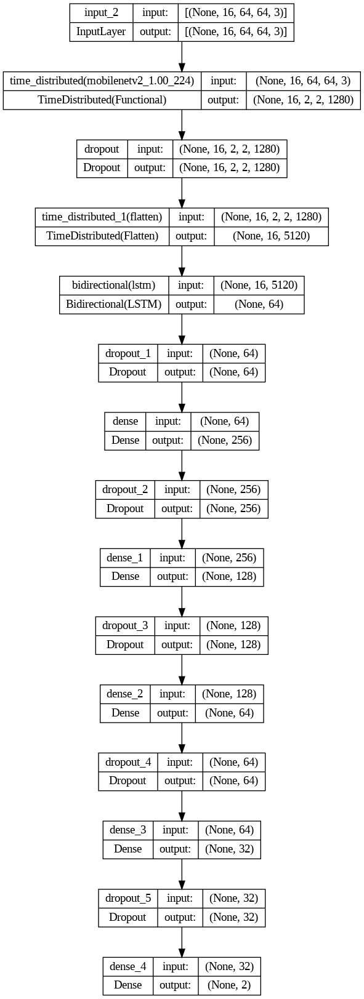

In [16]:
# Constructing the Model
MoBiLSTM_model = create_model()

# Plot the structure of the contructed LRCN model.
plot_model(MoBiLSTM_model, to_file = 'MobBiLSTM_model_structure_plot.png', show_shapes = True, show_layer_names = True)

CallBack Specification and Fitting

In [17]:
# Create Early Stopping Callback to monitor the accuracy
import tensorflow as tf
early_stopping_callback = EarlyStopping(monitor = 'val_accuracy', patience = 10, restore_best_weights = True)

# Create ReduceLROnPlateau Callback to reduce overfitting by decreasing learning
reduce_lr = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss',
                                                  factor=0.6,
                                                  patience=5,
                                                  min_lr=0.00005,
                                                  verbose=1)

# Compiling the model
MoBiLSTM_model.compile(loss = 'categorical_crossentropy', optimizer = 'sgd', metrics = ["accuracy"])

# Fitting the model
MobBiLSTM_model_history = MoBiLSTM_model.fit(x = features_train, y = labels_train, epochs = 50, batch_size = 8 ,
                                             shuffle = True, validation_split = 0.2, callbacks = [early_stopping_callback,reduce_lr])

Epoch 1/50
180/180 [==============================] - 30s 84ms/step - loss: 0.7007 - accuracy: 0.4983 - val_loss: 0.6971 - val_accuracy: 0.4639 - lr: 0.0100
Epoch 2/50
180/180 [==============================] - 11s 64ms/step - loss: 0.6937 - accuracy: 0.5129 - val_loss: 0.6952 - val_accuracy: 0.4639 - lr: 0.0100
Epoch 3/50
180/180 [==============================] - 12s 64ms/step - loss: 0.6853 - accuracy: 0.5691 - val_loss: 0.6606 - val_accuracy: 0.7111 - lr: 0.0100
Epoch 4/50
180/180 [==============================] - 14s 76ms/step - loss: 0.6490 - accuracy: 0.6303 - val_loss: 0.5630 - val_accuracy: 0.7861 - lr: 0.0100
Epoch 5/50
180/180 [==============================] - 11s 62ms/step - loss: 0.5539 - accuracy: 0.7582 - val_loss: 0.4312 - val_accuracy: 0.8139 - lr: 0.0100
Epoch 6/50
180/180 [==============================] - 11s 63ms/step - loss: 0.4655 - accuracy: 0.8117 - val_loss: 0.4527 - val_accuracy: 0.8333 - lr: 0.0100
Epoch 7/50
180/180 [==============================] - 12s 

In [18]:
model_evaluation_history = MoBiLSTM_model.evaluate(features_test, labels_test)


7/7 [==============================] - 4s 57ms/step - loss: 0.3031 - accuracy: 0.8900


Model Evaluation

In [19]:
def plot_metric(model_training_history, metric_name_1, metric_name_2, plot_name):

    metric_value_1 = model_training_history.history[metric_name_1]
    metric_value_2 = model_training_history.history[metric_name_2]

    # Get the Epochs Count
    epochs = range(len(metric_value_1))

    plt.plot(epochs, metric_value_1, 'blue', label = metric_name_1)
    plt.plot(epochs, metric_value_2, 'orange', label = metric_name_2)

    plt.title(str(plot_name))

    plt.legend()

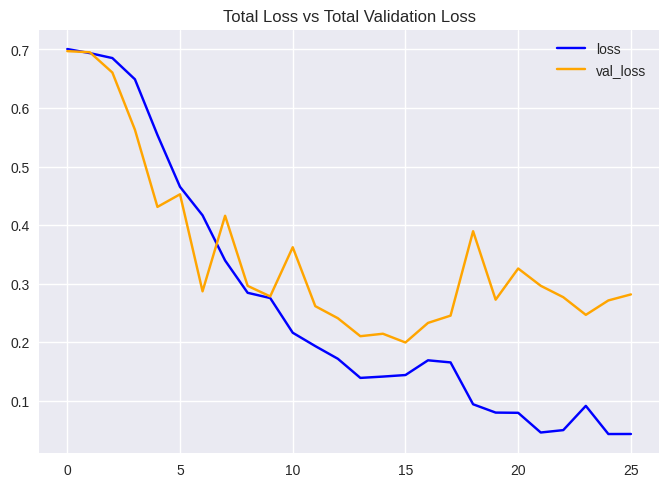

In [20]:
plot_metric(MobBiLSTM_model_history, 'loss', 'val_loss', 'Total Loss vs Total Validation Loss')

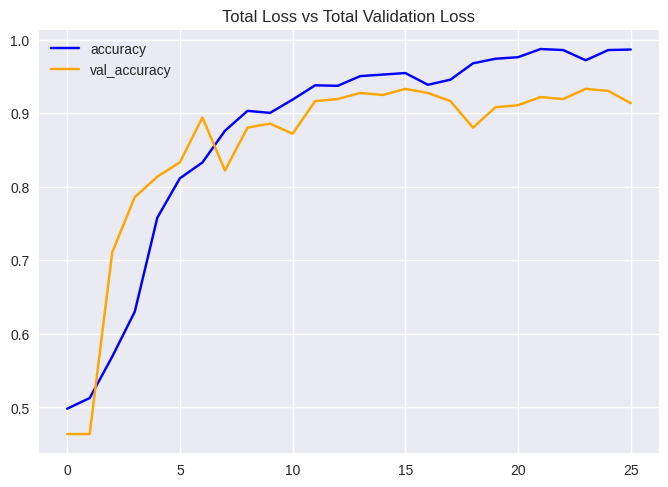

In [21]:
plot_metric(MobBiLSTM_model_history, 'accuracy', 'val_accuracy', 'Total Loss vs Total Validation Loss')



##Predicting The Test Set

In [22]:
labels_predict = MoBiLSTM_model.predict(features_test)


7/7 [==============================] - 2s 62ms/step


In [23]:
# Decoding the data to use in Metrics
labels_predict = np.argmax(labels_predict , axis=1)
labels_test_normal = np.argmax(labels_test , axis=1)

In [24]:
labels_test_normal.shape , labels_predict.shape

((200,), (200,))

Accuracy Score


In [25]:
from sklearn.metrics import accuracy_score
AccScore = accuracy_score(labels_predict, labels_test_normal)
print('Accuracy Score is : ', AccScore)

Accuracy Score is :  0.89


Confusion Matrix

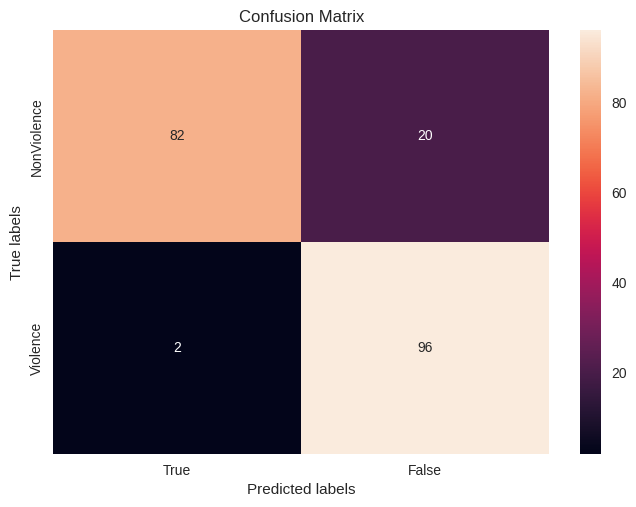

In [26]:
import seaborn as sns
from sklearn.metrics import confusion_matrix

ax= plt.subplot()
cm=confusion_matrix(labels_test_normal, labels_predict)
sns.heatmap(cm, annot=True, fmt='g', ax=ax);

ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels');
ax.set_title('Confusion Matrix');
ax.xaxis.set_ticklabels(['True', 'False']); ax.yaxis.set_ticklabels(['NonViolence', 'Violence']);


Classification Report

In [27]:
from sklearn.metrics import classification_report

ClassificationReport = classification_report(labels_test_normal,labels_predict)
print('Classification Report is : \n', ClassificationReport)

Classification Report is : 
               precision    recall  f1-score   support

           0       0.98      0.80      0.88       102
           1       0.83      0.98      0.90        98

    accuracy                           0.89       200
   macro avg       0.90      0.89      0.89       200
weighted avg       0.90      0.89      0.89       200



Frame by Frame Prediction

In [76]:
def predict_frames(video_file_path, output_file_path, SEQUENCE_LENGTH):

    # Read from the video file.
    video_reader = cv2.VideoCapture(video_file_path)

    # Get the width and height of the video.
    original_video_width = int(video_reader.get(cv2.CAP_PROP_FRAME_WIDTH))
    original_video_height = int(video_reader.get(cv2.CAP_PROP_FRAME_HEIGHT))

    # VideoWriter to store the output video in the disk.
    video_writer = cv2.VideoWriter(output_file_path, cv2.VideoWriter_fourcc('m', 'p', '4', 'v'),
                                    video_reader.get(cv2.CAP_PROP_FPS), (original_video_width, original_video_height))

    # Declare a queue to store video frames.
    frames_queue = deque(maxlen = SEQUENCE_LENGTH)

    # Store the predicted class in the video.
    predicted_class_name = ''

    # Iterate until the video is accessed successfully.
    while video_reader.isOpened():

        ok, frame = video_reader.read()

        if not ok:
            break

        # Resize the Frame to fixed Dimensions.
        resized_frame = cv2.resize(frame, (IMAGE_HEIGHT, IMAGE_WIDTH))

        # Normalize the resized frame
        normalized_frame = resized_frame / 255

        # Appending the pre-processed frame into the frames list.
        frames_queue.append(normalized_frame)

        # We Need at Least number of SEQUENCE_LENGTH Frames to perform a prediction.
        # Check if the number of frames in the queue are equal to the fixed sequence length.
        if len(frames_queue) == SEQUENCE_LENGTH:

            # Pass the normalized frames to the model and get the predicted probabilities.
            predicted_labels_probabilities = MoBiLSTM_model.predict(np.expand_dims(frames_queue, axis = 0))[0]

            # Get the index of class with highest probability.
            predicted_label = np.argmax(predicted_labels_probabilities)

            # Get the class name using the retrieved index.
            predicted_class_name = CLASSES_LIST[predicted_label]

        # Write predicted class name on top of the frame.
        if predicted_class_name == "Violence":
            cv2.putText(frame, predicted_class_name, (5, 100), cv2.FONT_HERSHEY_SIMPLEX, 3, (0, 0, 255), 12)
        else:
            cv2.putText(frame, predicted_class_name, (5, 100), cv2.FONT_HERSHEY_SIMPLEX, 3, (0, 255, 0), 12)

        # Write The frame into the disk using the VideoWriter
        video_writer.write(frame)

    video_reader.release()
    video_writer.release()

In [60]:
plt.style.use("default")

# To show Random Frames from the saved output predicted video (output predicted video doesn't show on the notebook but can be downloaded)
def show_pred_frames(pred_video_path):

    plt.figure(figsize=(20, 15))

    video_reader = cv2.VideoCapture(pred_video_path)

    # Get the number of frames in the video.
    frames_count = int(video_reader.get(cv2.CAP_PROP_FRAME_COUNT))

    if frames_count >= SEQUENCE_LENGTH + 11:
        # Select a maximum of 12 random frames, considering available frames
        num_frames_to_select = min(frames_count - SEQUENCE_LENGTH, 12)
        random_range = sorted(random.sample(range(SEQUENCE_LENGTH, frames_count), num_frames_to_select))

        for counter, random_index in enumerate(random_range, 1):

            plt.subplot(5, 4, counter)

            # Set the current frame position of the video.
            video_reader.set(cv2.CAP_PROP_POS_FRAMES, random_index)

            ok, frame = video_reader.read()

            if not ok:
                break

            frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

            plt.imshow(frame)
            plt.tight_layout()

    else:
        print(f"The output video has less than {SEQUENCE_LENGTH + 11} frames. Showing all available frames.")
        for i in range(SEQUENCE_LENGTH, frames_count):
            # Read and display each frame
            video_reader.set(cv2.CAP_PROP_POS_FRAMES, i)
            ok, frame = video_reader.read()
            if not ok:
                break
            frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
            plt.subplot(int(np.ceil(frames_count - SEQUENCE_LENGTH / 4)), 4, i - SEQUENCE_LENGTH + 1)  # Adjust layout for variable number of frames
            plt.imshow(frame)
            plt.tight_layout()

    video_reader.release()
    plt.show()



In [55]:
# Construct the output video path.
test_videos_directory = 'test_videos'
os.makedirs(test_videos_directory, exist_ok = True)

output_video_file_path = f'{test_videos_directory}/Output-Test-Video.mp4'

1/1 [==============================] - 0s 24ms/step


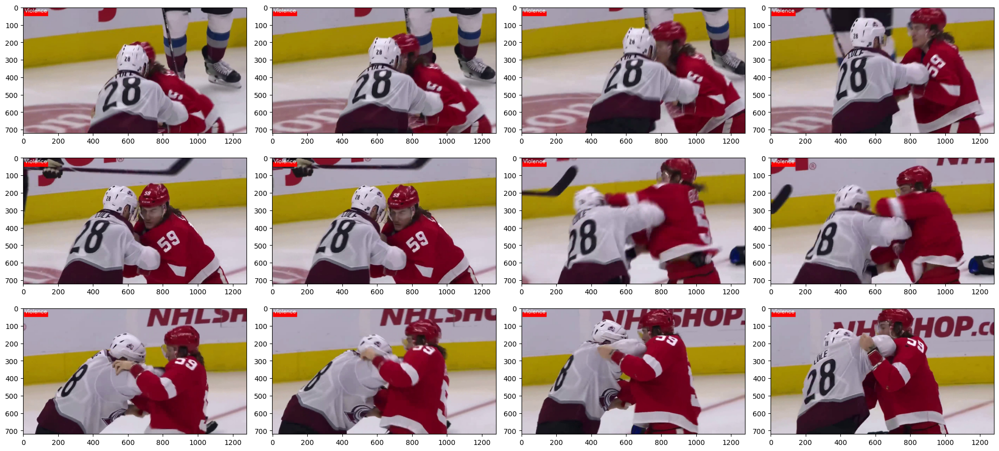

In [77]:


# Specifying video to be predicted
input_video_file_path = "/content/drive/MyDrive/archive/real life violence situations/Real Life Violence Dataset/Violence/V_308.mp4"

# Perform Prediction on the Test Video.
predict_frames(input_video_file_path, output_video_file_path, SEQUENCE_LENGTH)

# Show random frames from the output video
show_pred_frames(output_video_file_path)



In [66]:
# Play the actual video
Play_Video(input_video_file_path)

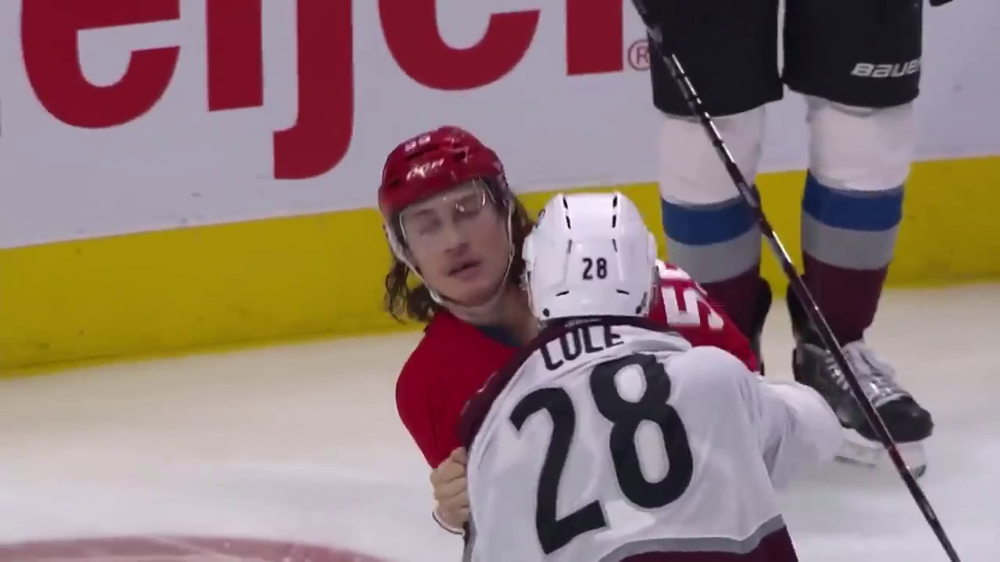

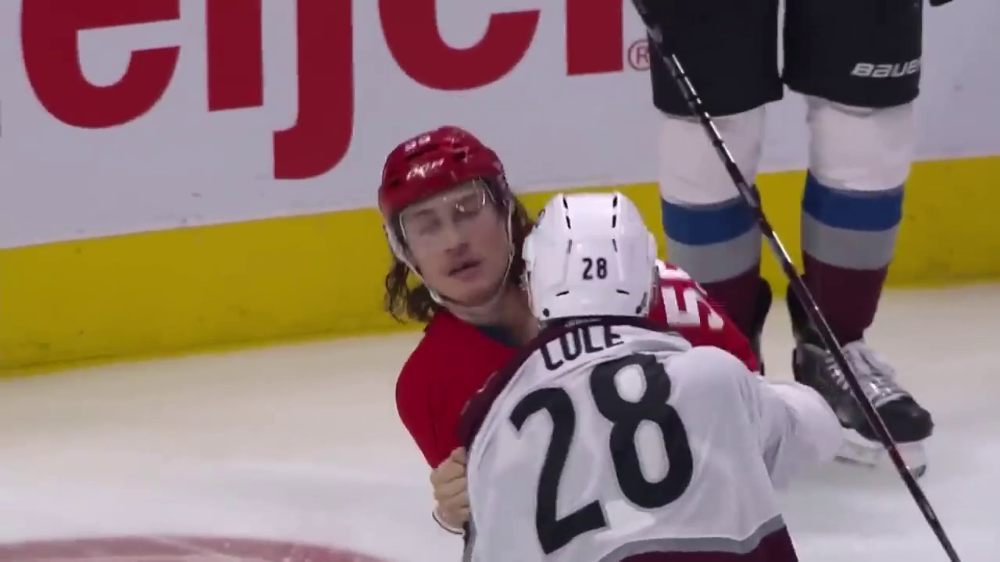

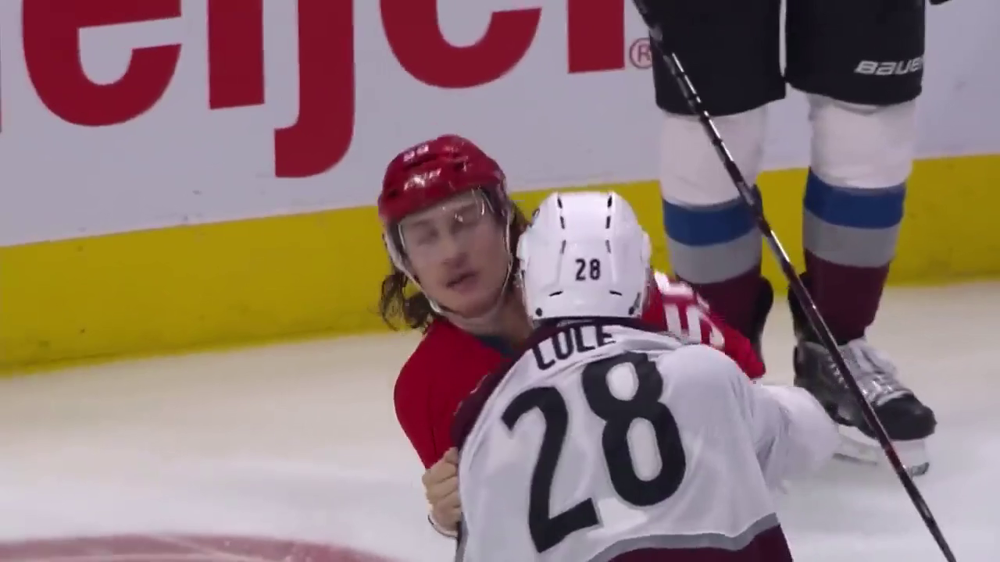

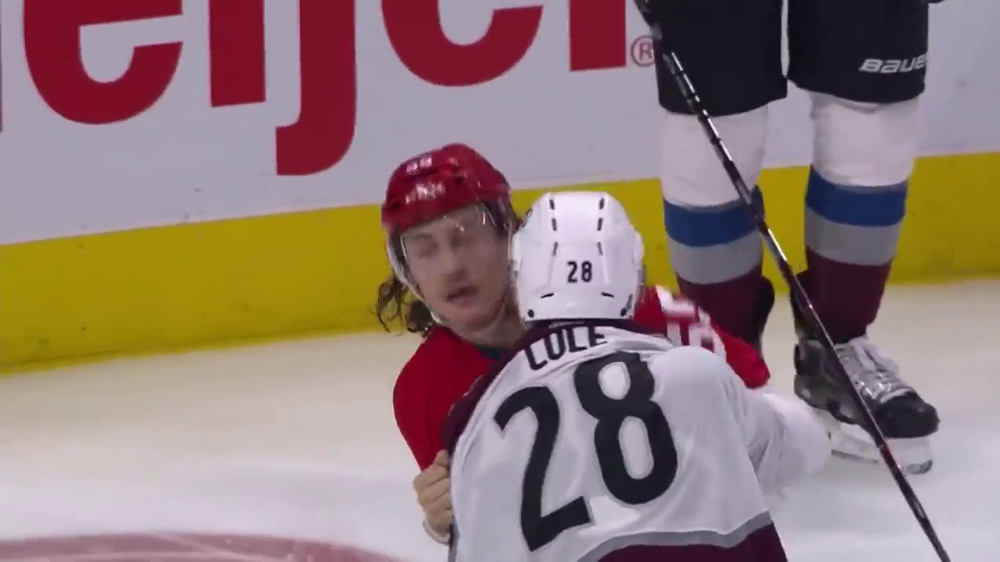

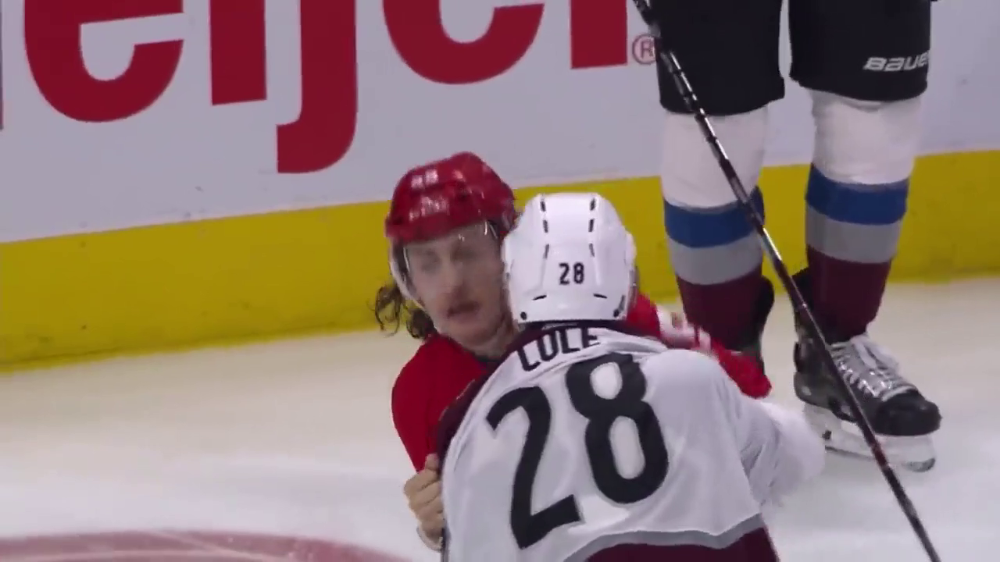

...

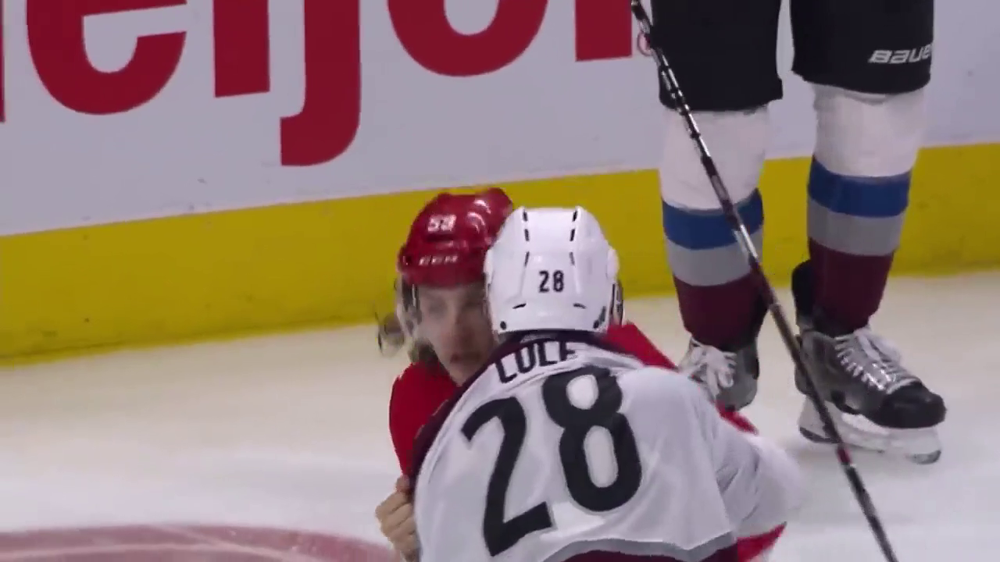

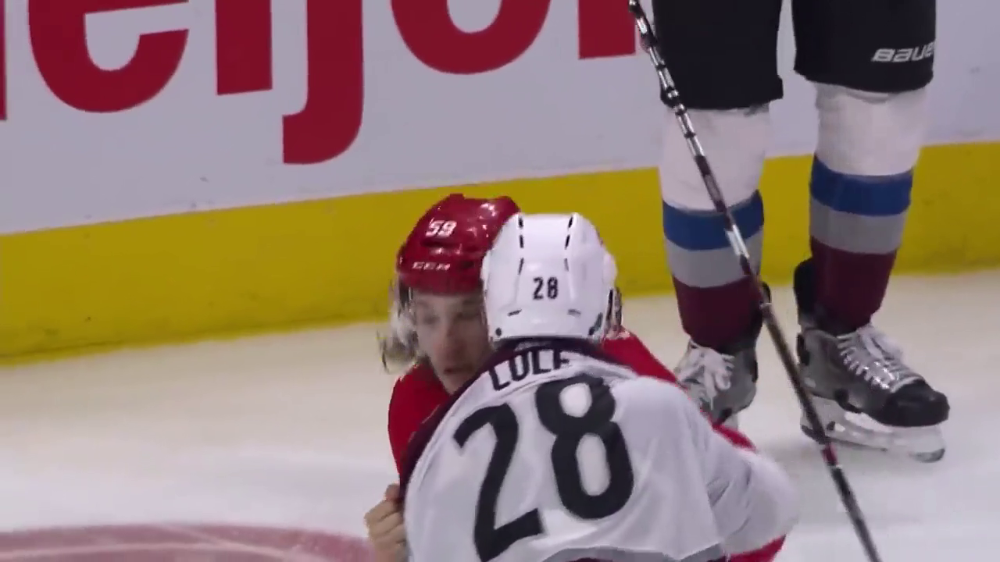

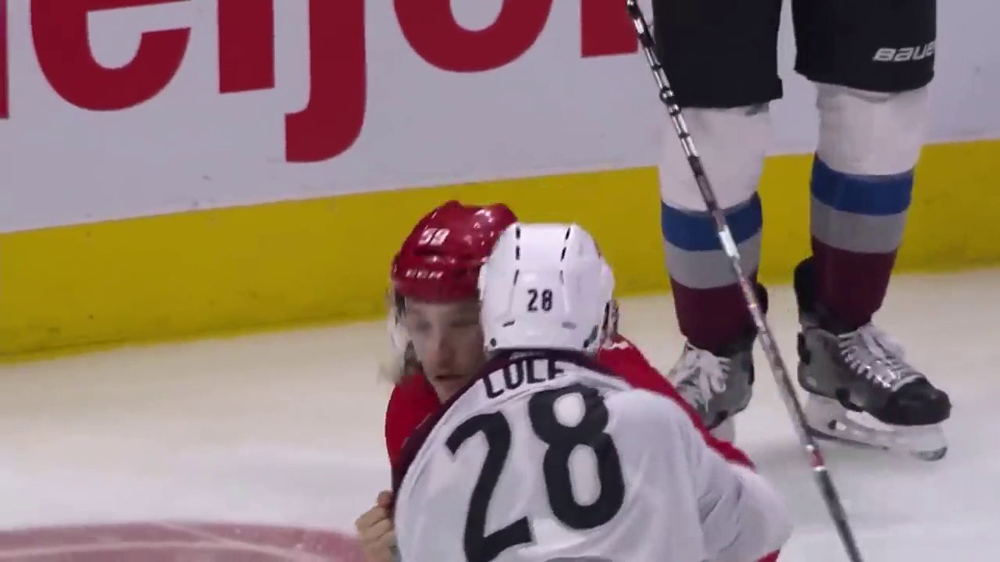

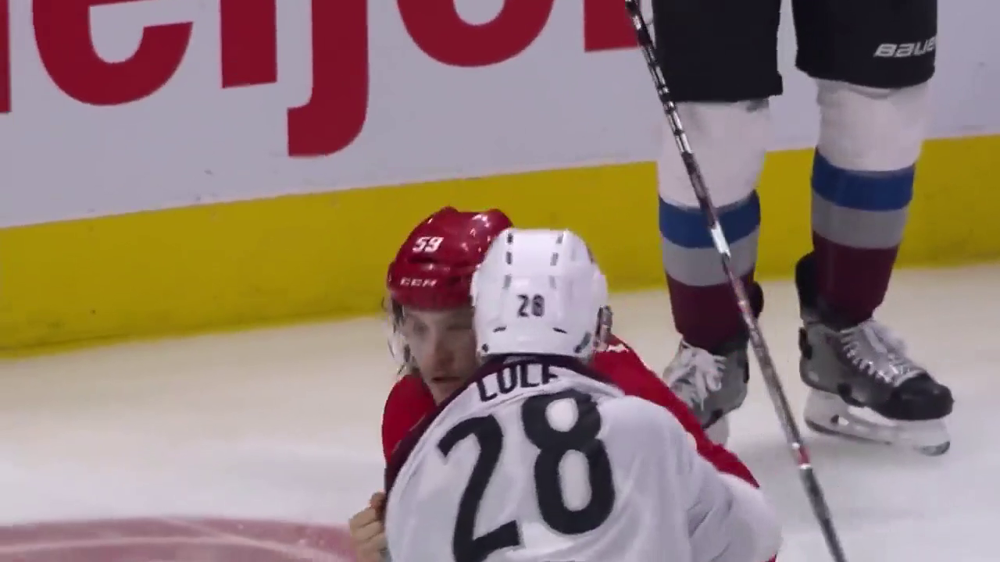

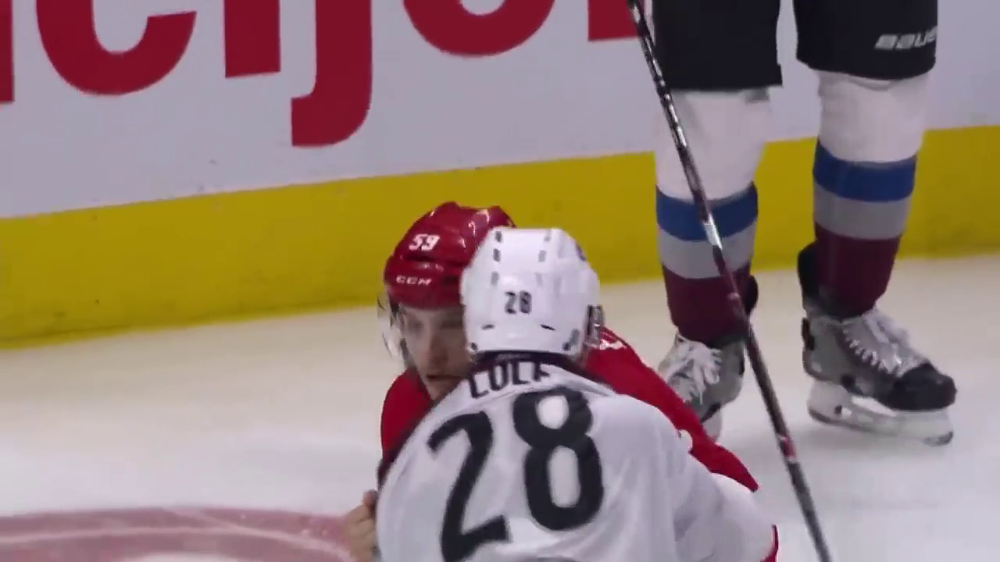

In [ ]:
import cv2
from google.colab.patches import cv2_imshow

def play_video_with_prediction(video_file_path):

    cap = cv2.VideoCapture(video_file_path)

    while True:
        ret, frame = cap.read()

        if not ret:
            break

        # Process the frame using your prediction logic (e.g., call predict_frames)
        # This should update the frame with text overlay based on prediction

        # Display the processed frame
        cv2_imshow(frame)

        # Handle keyboard input for exit (e.g., press 'q' to quit)
        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    cap.release()
    cv2.destroyAllWindows()

# Play the video with real-time prediction
play_video_with_prediction(input_video_file_path)

1/1 [==============================] - 0s 25ms/step


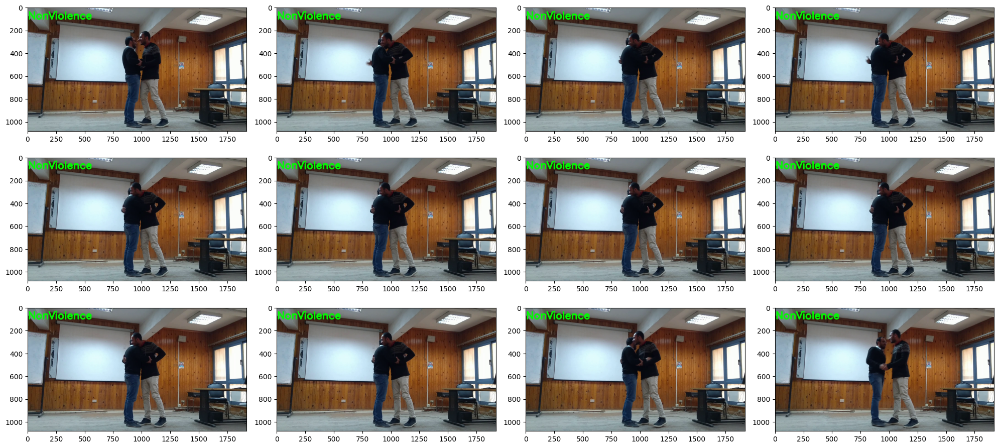

In [67]:
# Specifying video to be predicted
input_video_file_path = "/content/drive/MyDrive/archive/real life violence situations/Real Life Violence Dataset/NonViolence/NV_1.mp4"

# Perform Prediction on the Test Video.
predict_frames(input_video_file_path, output_video_file_path, SEQUENCE_LENGTH)

# Show random frames from the output video
show_pred_frames(output_video_file_path)

In [68]:

# Play the actual video
Play_Video(input_video_file_path)

In [71]:
def predict_video(video_file_path, SEQUENCE_LENGTH):

    video_reader = cv2.VideoCapture(video_file_path)

    # Get the width and height of the video.
    original_video_width = int(video_reader.get(cv2.CAP_PROP_FRAME_WIDTH))
    original_video_height = int(video_reader.get(cv2.CAP_PROP_FRAME_HEIGHT))

    # Declare a list to store video frames we will extract.
    frames_list = []

    # Store the predicted class in the video.
    predicted_class_name = ''

    # Get the number of frames in the video.
    video_frames_count = int(video_reader.get(cv2.CAP_PROP_FRAME_COUNT))

    # Calculate the interval after which frames will be added to the list.
    skip_frames_window = max(int(video_frames_count/SEQUENCE_LENGTH),1)

    # Iterating the number of times equal to the fixed length of sequence.
    for frame_counter in range(SEQUENCE_LENGTH):

        # Set the current frame position of the video.
        video_reader.set(cv2.CAP_PROP_POS_FRAMES, frame_counter * skip_frames_window)

        success, frame = video_reader.read()

        if not success:
            break

        # Resize the Frame to fixed Dimensions.
        resized_frame = cv2.resize(frame, (IMAGE_HEIGHT, IMAGE_WIDTH))

        # Normalize the resized frame.
        normalized_frame = resized_frame / 255

        # Appending the pre-processed frame into the frames list
        frames_list.append(normalized_frame)

    # Passing the  pre-processed frames to the model and get the predicted probabilities.
    predicted_labels_probabilities = MoBiLSTM_model.predict(np.expand_dims(frames_list, axis = 0))[0]

    # Get the index of class with highest probability.
    predicted_label = np.argmax(predicted_labels_probabilities)

    # Get the class name using the retrieved index.
    predicted_class_name = CLASSES_LIST[predicted_label]

    # Display the predicted class along with the prediction confidence.
    print(f'Predicted: {predicted_class_name}\nConfidence: {predicted_labels_probabilities[predicted_label]}')

    video_reader.release()

In [73]:
# Specifying video to be predicted
input_video_file_path = "/content/drive/MyDrive/archive/real life violence situations/Real Life Violence Dataset/Violence/V_276.mp4"

# Perform Single Prediction on the Test Video.
predict_video(input_video_file_path, SEQUENCE_LENGTH)

# Play the actual video
Play_Video(input_video_file_path)

1/1 [==============================] - 0s 25ms/step
Predicted: Violence
Confidence: 0.9997496008872986


In [75]:


# Specifying video to be predicted
input_video_file_path = "/content/drive/MyDrive/archive/real life violence situations/Real Life Violence Dataset/NonViolence/NV_23.mp4"

# Perform Single Prediction on the Test Video.
predict_video(input_video_file_path, SEQUENCE_LENGTH)

# Play the actual video
Play_Video(input_video_file_path)



1/1 [==============================] - 0s 25ms/step
Predicted: NonViolence
Confidence: 0.9912269711494446


#Preprocessing

The datasets videos appear in shape of (V, F,..., 3) where V represents the number of dataset videos, F represents the number of video frames, represents the width of frame i and represent the height of frame i. These input videos go through a sequence of pre- processing operations as follows; First each frame of the input videos is resized into 224×224×3. Two data augmentation techniques are used to increase the size of the data e.g. blurring, vertical flipping and adding vertical lines. Fig. 2 shows a sample of the applied data augmentation process. Afterward, the hockey fight [2], movie [2] and violent- flow [7] datasets are shuffled separately and each dataset is split into 80% for training and 20% as a validation set. The output size of this step is (V, F, 224, 224, and 3).


#Feature Extraction

The datasets videos appear in shape of (V, F,..., 3) where V represents the number of dataset videos, F represents the number of video frames, represents the width of frame i and represent the height of frame i. These input videos go through a sequence of pre- processing operations as follows; First each frame of the input videos is resized into 224×224×3. Two data augmentation techniques are used to increase the size of the data e.g. blurring, vertical flipping and adding vertical lines. Fig. 2 shows a sample of the applied data augmentation process. Afterward, the hockey fight [2], movie [2] and violent- flow [7] datasets are shuffled separately and each dataset is split into 80% for training and 20% as a validation set. The output size of this step is (V, F, 224, 224, and 3).


#Classification
The datasets videos appear in shape of (V, F,..., 3) where V represents the number of dataset videos, F represents the number of video frames, represents the width of frame i and represent the height of frame i. These input videos go through a sequence of pre- processing operations as follows; First each frame of the input videos is resized into 224×224×3. Two data augmentation techniques are used to increase the size of the data e.g. blurring, vertical flipping and adding vertical lines. Fig. 2 shows a sample of the applied data augmentation process. Afterward, the hockey fight [2], movie [2] and violent- flow [7] datasets are shuffled separately and each dataset is split into 80% for training and 20% as a validation set. The output size of this step is (V, F, 224, 224, and 3).


#Fine Tuning
The datasets videos appear in shape of (V, F,..., 3) where V represents the number of dataset videos, F represents the number of video frames, represents the width of frame i and represent the height of frame i. These input videos go through a sequence of pre- processing operations as follows; First each frame of the input videos is resized into 224×224×3. Two data augmentation techniques are used to increase the size of the data e.g. blurring, vertical flipping and adding vertical lines. Fig. 2 shows a sample of the applied data augmentation process. Afterward, the hockey fight [2], movie [2] and violent- flow [7] datasets are shuffled separately and each dataset is split into 80% for training and 20% as a validation set. The output size of this step is (V, F, 224, 224, and 3).
